In [9]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt

%matplotlib inline

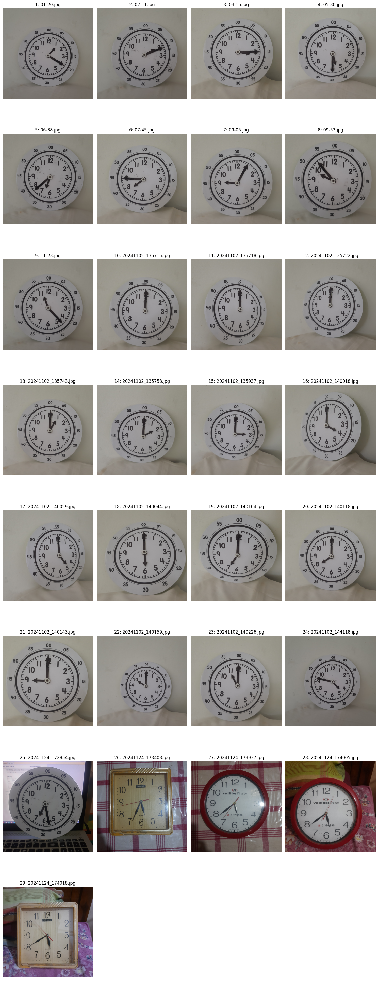

In [10]:
import glob
import cv2
import matplotlib.pyplot as plt
import os

# Get all image file paths
image_paths = glob.glob('../data/test_images/captured-images/*.jpg')  # Adjust the extension if needed

# Read and append images to the list
images = []
for path in image_paths:
    img = cv2.imread(path)
    images.append(img)

# Display images using subplots
num_images = len(images)
cols = 4  # Number of columns
rows = (num_images + cols - 1) // cols  # Calculate rows needed

fig, axes = plt.subplots(rows, cols, figsize=(15, 5 * rows))

for idx, img in enumerate(images):
    ax = axes[idx // cols, idx % cols]
    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax.imshow(img_rgb)
    ax.axis('off')
    # Add index starting from 1 and file name as the title
    filename = os.path.basename(image_paths[idx])
    ax.set_title(f"{idx + 1}: {filename}")

# Hide any unused subplots
for ax in axes.flat[num_images:]:
    ax.axis('off')

plt.tight_layout()
plt.show()

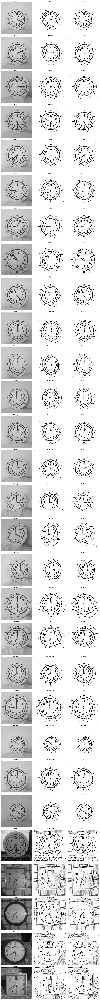

In [11]:
import glob
import cv2
import matplotlib.pyplot as plt
import os

# Get all image file paths
image_paths = glob.glob('../data/test_images/captured-images/*.jpg')

# Read and process images
images = []
adaptive_thresh = []
otsu_thresh = []

for path in image_paths:
    # Read as grayscale
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    # Apply adaptive threshold
    th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, 
                               cv2.THRESH_BINARY, 51, 10)
    # Apply Otsu's threshold
    _, th4 = cv2.threshold(th2, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    images.append(img)
    adaptive_thresh.append(th2)
    otsu_thresh.append(th4)

# Display results
num_images = len(images)
cols = 3  # Original, Adaptive, Otsu
rows = num_images

fig, axes = plt.subplots(rows, cols, figsize=(15, 5 * rows))

for idx in range(num_images):
    # Original
    axes[idx, 0].imshow(images[idx], 'gray')
    axes[idx, 0].axis('off')
    filename = os.path.basename(image_paths[idx])
    axes[idx, 0].set_title(f"{idx + 1}: Original")
    
    # Adaptive threshold
    axes[idx, 1].imshow(adaptive_thresh[idx], 'gray')
    axes[idx, 1].axis('off')
    axes[idx, 1].set_title(f"{idx + 1}: Adaptive")
    
    # Otsu threshold
    axes[idx, 2].imshow(otsu_thresh[idx], 'gray')
    axes[idx, 2].axis('off')
    axes[idx, 2].set_title(f"{idx + 1}: Otsu")

plt.tight_layout()
plt.show()


0: 640x640 1 clock, 132.6ms
Speed: 8.0ms preprocess, 132.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 250.3ms
Speed: 12.0ms preprocess, 250.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 208.9ms
Speed: 12.0ms preprocess, 208.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 216.4ms
Speed: 14.0ms preprocess, 216.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 307.7ms
Speed: 14.0ms preprocess, 307.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 201.5ms
Speed: 12.0ms preprocess, 201.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 208.4ms
Speed: 13.0ms preprocess, 208.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 211.4ms
Speed: 12.0ms preprocess, 211.4ms inference, 3.0ms postprocess per image at 

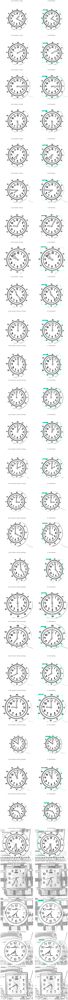

In [14]:
import cv2
import numpy as np
from ultralytics import YOLO
import matplotlib.pyplot as plt
import os

# Load the YOLO model once
model = YOLO('yolo11s.pt')

# Create temp directory if it doesn't exist
temp_dir = './temp_images'
os.makedirs(temp_dir, exist_ok=True)

# Display results
num_images = len(otsu_thresh)
cols = 2  # Original and Prediction
rows = num_images

fig, axes = plt.subplots(rows, cols, figsize=(15, 7 * rows))

for idx in range(num_images):
    # Save Otsu thresholded image temporarily
    temp_path = os.path.join(temp_dir, f'temp_{idx}.jpg')
    cv2.imwrite(temp_path, otsu_thresh[idx])
    
    # Load and process with YOLO
    image = cv2.imread(temp_path)
    results = model(image, conf=0.5, iou=0.4)
    
    # Original Otsu threshold
    axes[idx, 0].imshow(otsu_thresh[idx], 'gray')
    axes[idx, 0].axis('off')
    filename = os.path.basename(image_paths[idx])
    axes[idx, 0].set_title(f"{idx + 1}: Otsu Threshold - {filename}")
    
    # YOLO predictions
    for result in results:
        result_image = result.plot()
        axes[idx, 1].imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
        axes[idx, 1].axis('off')
        axes[idx, 1].set_title(f"{idx + 1}: YOLO Predictions")
    
    # Remove temporary file
    os.remove(temp_path)

plt.tight_layout()
plt.show()

# Clean up temp directory
os.rmdir(temp_dir)


0: 640x640 1 clock, 53.9ms
Speed: 10.0ms preprocess, 53.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 156.6ms
Speed: 13.0ms preprocess, 156.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 235.5ms
Speed: 12.0ms preprocess, 235.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 245.4ms
Speed: 12.0ms preprocess, 245.4ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 118.7ms
Speed: 12.0ms preprocess, 118.7ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 222.4ms
Speed: 12.0ms preprocess, 222.4ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 234.3ms
Speed: 13.0ms preprocess, 234.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 clock, 242.4ms
Speed: 13.0ms preprocess, 242.4ms inference, 4.0ms postprocess per image at s

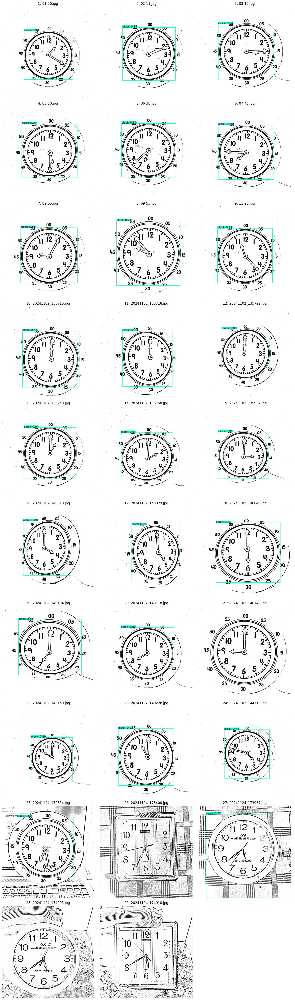

In [ ]:
import cv2
import numpy as np
from ultralytics import YOLO
import matplotlib.pyplot as plt
import os

# Load the YOLO model once
model = YOLO('yolo11s.pt')

# Create temp directory if it doesn't exist
temp_dir = './temp_images'
os.makedirs(temp_dir, exist_ok=True)

# Display results
num_images = len(otsu_thresh)
cols = 3  # Number of columns for predictions
rows = (num_images + cols - 1) // cols  # Calculate needed rows

fig, axes = plt.subplots(rows, cols, figsize=(15, 5 * rows))
axes = axes.flatten() if rows > 1 else [axes]

for idx in range(num_images):
    # Save Otsu thresholded image temporarily
    temp_path = os.path.join(temp_dir, f'temp_{idx}.jpg')
    cv2.imwrite(temp_path, otsu_thresh[idx])
    
    # Load and process with YOLO
    image = cv2.imread(temp_path)
    results = model(image, conf=0.5, iou=0.4)
    
    # YOLO predictions
    for result in results:
        result_image = result.plot()
        axes[idx].imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
        axes[idx].axis('off')
        filename = os.path.basename(image_paths[idx])
        axes[idx].set_title(f"{idx + 1}: {filename}")
    
    # Remove temporary file
    os.remove(temp_path)

# Hide unused subplots
for idx in range(num_images, len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

# Clean up temp directory
os.rmdir(temp_dir)